# TAREA 1 - VISIÓN COMPUTACIONAL (SIFT)


> Presentado por:
- Santiago Aristizabal
- Luis Fernando Muñoz



# **Explicación**

[sift](https://docs.opencv.org/3.4/da/df5/tutorial_py_sift_intro.html)

[surf](https://docs.opencv.org/3.4/df/dd2/tutorial_py_surf_intro.html)

# Ejercicios

1. Explica con tus propias palabras el algoritmo SURF para hallar puntos clave


> El algoritmo **SURF (Speeded Up Robust Features)** tiene la finalidad para detección de puntos claves en una imagen como el algoritmo SIFT y otros destinados a detección de kp en una imagen. Lo que caracteriza al SURF es su forma de detectar mediante Laplaciano de la Gaussiana y el filtro de caja, que consta de realizar detecciones de bordes y cambios de intensidad para agrupar los conjuntos que detecte con cambios de intesidad y similares al pixel.
Con esta característica de ubicación logra ser un modelo más rápido que el SIFT y además cuando se van a representar como vectores, que bien en SIFT se usa 128 bins, en este caso se usan 64 bins, permitiendo subir la velocidad del cálculo en cada paso, siendo un modelo rápido y capaz de realizar detección en imágenes con rotación. En el github creado por los estudiantes se explica mas a fondo
>
>
> [Repositorio Github](https://github.com/sam2800ml/Vision_Computacional/tree/master/Descriptores)





2. Realizar el sugiente ejercicio con puntos clave SIFT, SURF y escoge otro extractor de puntos claves. (Explica diferencias del resultado con los métodos)

Si desea capturar una escena grande y su cámara solo puede proporcionar una imagen con una resolución específica y esa resolución es de 640 por 480, ciertamente no es suficiente para capturar la gran vista panorámica. Por lo tanto, podemos capturar múltiples imágenes de la escena completa y luego juntar todas las partes en una imagen grande. Estas fotografías de escenas ordenadas de unidades de área de colecciones se denominan panorámicas. Todo el proceso de adquirir múltiples imágenes y fusionarlas en dichos panoramas se denomina unión de imágenes. Y finalmente, tenemos una fotografía grande de la vista panorámica.

**Una la imágenes de la 1 a la 6 para formar esta panóramica**

Recuerde que  debe ir haciendo matching de caracteristicas solo con imagenes originales y trabajar con la multiplicación de homografias para ir acomodandolas.

SOLO PUEDE HACER MATCHING CON DOS IMAGENES ORIGINALES, NO PUEDE UNIR DOS IMAGENES Y COMPARAR CON UNA TERCERA

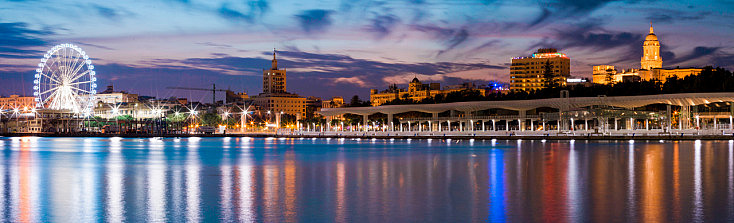

Cuando vaya uniendo imágenes le quedará un espacio negro cómo el de la siguiente imagen de ejemplo. Documente como puede borrar ese espacio negro para unir las siguientes imágenes y que no quede ese espacio (use condicionales)

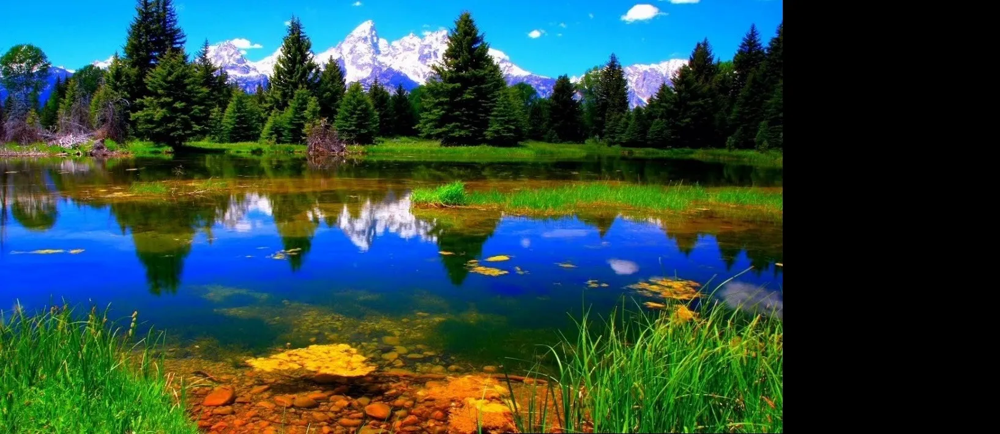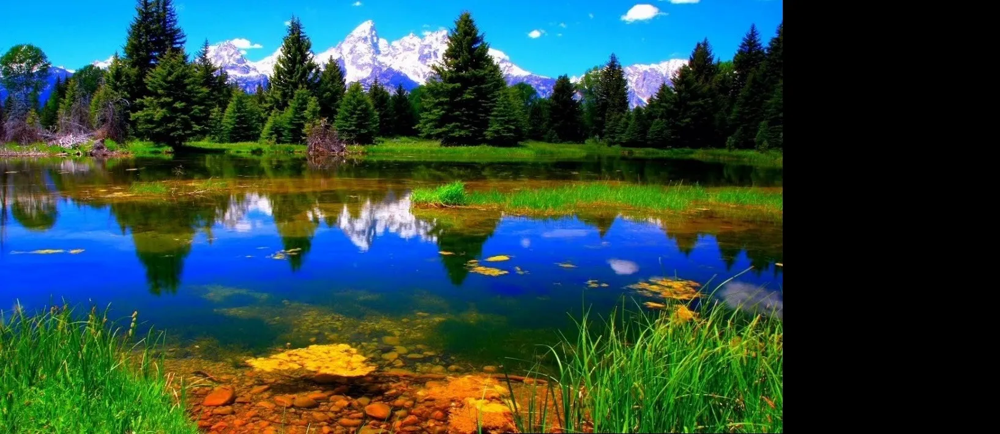

# Clonación del repositorio, importación de librerias y visualización de las imágenes

In [ ]:
!git clone https://github.com/sam2800ml/Vision_Computacional

Cloning into 'Vision_Computacional'...
remote: Enumerating objects: 99, done.
remote: Counting objects: 100% (99/99), done.
remote: Compressing objects: 100% (73/73), done.
remote: Total 99 (delta 32), reused 81 (delta 14), pack-reused 0
Receiving objects: 100% (99/99), 12.01 MiB | 30.07 MiB/s, done.
Resolving deltas: 100% (32/32), done.


In [ ]:
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt

In [ ]:
!unzip /content/Vision_Computacional/Imagenes/sift_surf.zip

Archive:  /content/Vision_Computacional/Imagenes/sift_surf.zip
  inflating: STITCH/panoramica.jpg   
  inflating: STITCH/4.jpg            
  inflating: STITCH/3.jpg            
  inflating: STITCH/1.jpg            
  inflating: STITCH/5.jpg            
  inflating: STITCH/2.jpg            
  inflating: STITCH/6.jpg            


In [ ]:
imagen1 = "/content/STITCH/1.jpg"
imagen2 = "/content/STITCH/2.jpg"
imagen3 = "/content/STITCH/3.jpg"
imagen4 = "/content/STITCH/4.jpg"
imagen5 = "/content/STITCH/5.jpg"
imagen6 = "/content/STITCH/6.jpg"

In [ ]:
img_gris1 = cv2.imread(imagen1,0)
img_rgb1 = cv2.cvtColor(cv2.imread(imagen1), cv2.COLOR_BGR2RGB)

img_gris2 = cv2.imread(imagen2,0)
img_rgb2 = cv2.cvtColor(cv2.imread(imagen2), cv2.COLOR_BGR2RGB)

img_gris3 = cv2.imread(imagen3,0)
img_rgb3 = cv2.cvtColor(cv2.imread(imagen3), cv2.COLOR_BGR2RGB)

img_gris4 = cv2.imread(imagen4,0)
img_rgb4 = cv2.cvtColor(cv2.imread(imagen4), cv2.COLOR_BGR2RGB)

img_gris5 = cv2.imread(imagen5,0)
img_rgb5 = cv2.cvtColor(cv2.imread(imagen5), cv2.COLOR_BGR2RGB)

img_gris6 = cv2.imread(imagen6,0)
img_rgb6 = cv2.cvtColor(cv2.imread(imagen6), cv2.COLOR_BGR2RGB)

In [ ]:
img_rgb1 = cv2.resize(img_rgb1,(img_rgb1.shape[1],150))
img_rgb2 = cv2.resize(img_rgb2,(img_rgb2.shape[1],150))
img_rgb3 = cv2.resize(img_rgb3,(img_rgb3.shape[1],150))
img_rgb4 = cv2.resize(img_rgb4,(img_rgb4.shape[1],150))
img_rgb5 = cv2.resize(img_rgb5,(img_rgb5.shape[1],150))
img_rgb6 = cv2.resize(img_rgb6,(img_rgb6.shape[1],150))

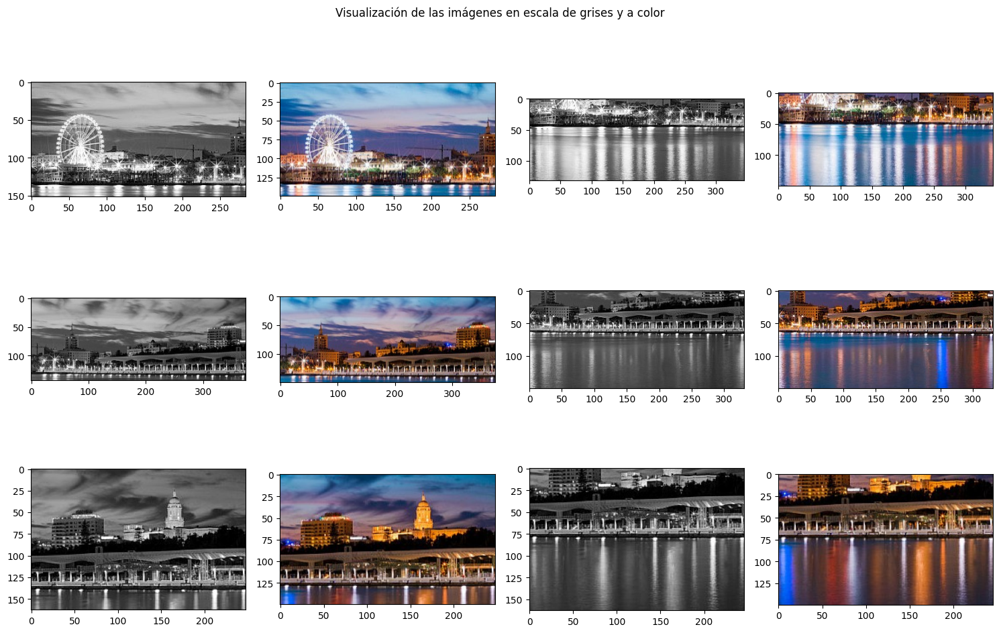

In [ ]:
plt.figure(figsize=(15,10))
plt.subplot(3,4,1), plt.imshow(img_gris1, cmap="gray")
plt.subplot(3,4,2), plt.imshow(img_rgb1, cmap="gray")
plt.subplot(3,4,3), plt.imshow(img_gris2, cmap="gray")
plt.subplot(3,4,4), plt.imshow(img_rgb2, cmap="gray")
plt.subplot(3,4,5), plt.imshow(img_gris3, cmap="gray")
plt.subplot(3,4,6), plt.imshow(img_rgb3, cmap="gray")
plt.subplot(3,4,7), plt.imshow(img_gris4, cmap="gray")
plt.subplot(3,4,8), plt.imshow(img_rgb4, cmap="gray")
plt.subplot(3,4,9), plt.imshow(img_gris5, cmap="gray")
plt.subplot(3,4,10), plt.imshow(img_rgb5, cmap="gray")
plt.subplot(3,4,11), plt.imshow(img_gris6, cmap="gray")
plt.subplot(3,4,12), plt.imshow(img_rgb6, cmap="gray")
plt.suptitle("Visualización de las imágenes en escala de grises y a color")
plt.tight_layout()
plt.show()

# **SIFT**


In [ ]:
feature_extractor = cv2.SIFT_create()
kp_1,des_1 = feature_extractor.detectAndCompute(img_gris1,None)
kp_2,des_2 = feature_extractor.detectAndCompute(img_gris2,None)
kp_3,des_3 = feature_extractor.detectAndCompute(img_gris3,None)
kp_4,des_4 = feature_extractor.detectAndCompute(img_gris4,None)
kp_5,des_5 = feature_extractor.detectAndCompute(img_gris5,None)
kp_6,des_6 = feature_extractor.detectAndCompute(img_gris6,None)

In [ ]:
print("Keypoints imagen 1: ",np.array(kp_1).shape,np.array(des_1).shape )
print("Keypoints imagen 2: ",np.array(kp_2).shape, np.array(des_2).shape)
print("Keypoints imagen 3: ",np.array(kp_3).shape, np.array(des_3).shape)
print("Keypoints imagen 4: ",np.array(kp_4).shape, np.array(des_4).shape)
print("Keypoints imagen 5: ",np.array(kp_5).shape, np.array(des_5).shape)
print("Keypoints imagen 6: ",np.array(kp_6).shape, np.array(des_6).shape)


Keypoints imagen 1:  (303,) (303, 128)
Keypoints imagen 2:  (316,) (316, 128)
Keypoints imagen 3:  (512,) (512, 128)
Keypoints imagen 4:  (381,) (381, 128)
Keypoints imagen 5:  (334,) (334, 128)
Keypoints imagen 6:  (296,) (296, 128)


In [ ]:
im_kp_1 = cv2.drawKeypoints(img_rgb1, kp_1, None, flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
im_kp_2 = cv2.drawKeypoints(img_rgb2, kp_2, None, flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
im_kp_3 = cv2.drawKeypoints(img_rgb3, kp_3, None, flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
im_kp_4 = cv2.drawKeypoints(img_rgb4, kp_4, None, flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
im_kp_5 = cv2.drawKeypoints(img_rgb5, kp_5, None, flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
im_kp_6 = cv2.drawKeypoints(img_rgb6, kp_6, None, flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)

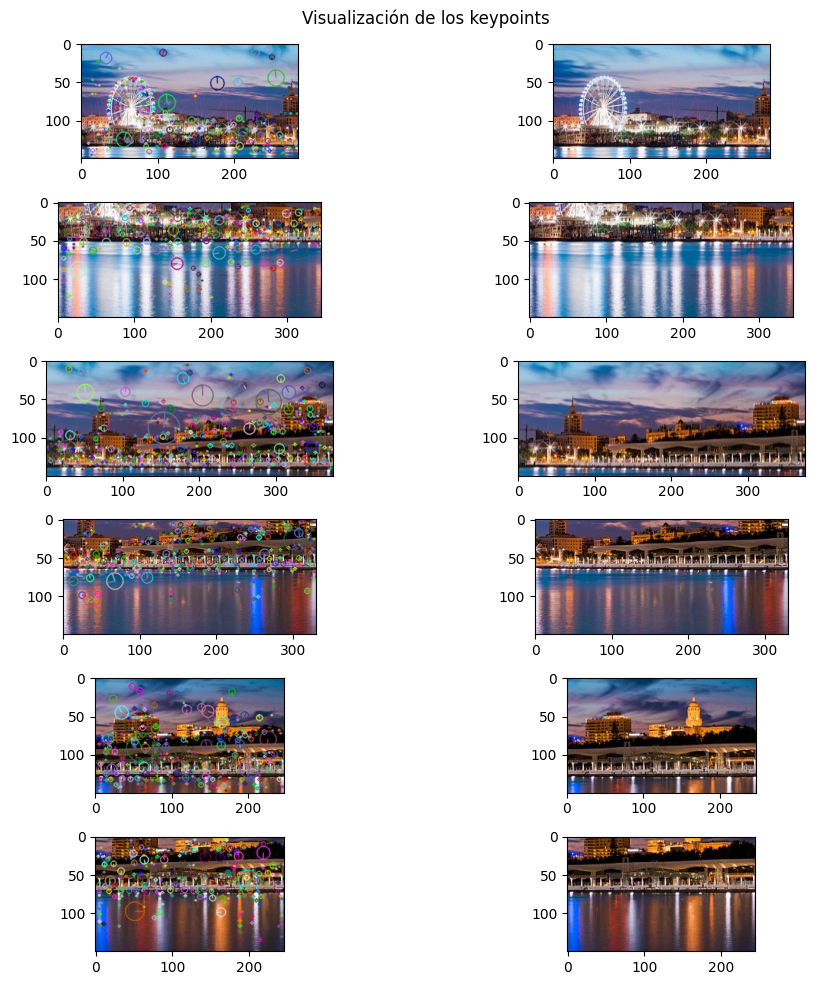

In [ ]:
plt.figure(figsize=(10,10))
plt.suptitle("Visualización de los keypoints")
plt.subplot(6,2,1),plt.imshow(im_kp_1, cmap="gray")
plt.subplot(6,2,2),plt.imshow(img_rgb1, cmap="gray")
plt.subplot(6,2,3),plt.imshow(im_kp_2, cmap="gray")
plt.subplot(6,2,4),plt.imshow(img_rgb2, cmap="gray")
plt.subplot(6,2,5),plt.imshow(im_kp_3, cmap="gray")
plt.subplot(6,2,6),plt.imshow(img_rgb3, cmap="gray")
plt.subplot(6,2,7),plt.imshow(im_kp_4, cmap="gray")
plt.subplot(6,2,8),plt.imshow(img_rgb4, cmap="gray")
plt.subplot(6,2,9),plt.imshow(im_kp_5, cmap="gray")
plt.subplot(6,2,10),plt.imshow(img_rgb5, cmap="gray")
plt.subplot(6,2,11),plt.imshow(im_kp_6, cmap="gray")
plt.subplot(6,2,12),plt.imshow(img_rgb6, cmap="gray")
plt.tight_layout()
plt.show()

In [ ]:
bf = cv2.BFMatcher()
matches1to2 = bf.knnMatch(des_1, des_2, k=2)
matches1to3 = bf.knnMatch(des_1, des_3, k=2)
matches2to4 = bf.knnMatch(des_2,des_4, k=2)
matches3to4 = bf.knnMatch(des_3, des_4, k=2)
matches3to5 = bf.knnMatch(des_3, des_5, k=2)
matches4to6 = bf.knnMatch(des_4,des_6,  k=2)
matches5to6 = bf.knnMatch(des_5, des_6, k=2)

In [ ]:
good_matches_1_2 = []
good_matches_1_3 = []
good_matches_2_4 = []
good_matches_3_4 = []
good_matches_3_5 = []
good_matches_4_6 = []
good_matches_5_6 = []

for m in matches1to2:
  if m[0].distance / m[1].distance < 0.4:
    good_matches_1_2.append(m)
good_match_arr1_2 = np.array(good_matches_1_2)

for m in matches1to3:
  if m[0].distance / m[1].distance < 0.4:
    good_matches_1_3.append(m)
good_match_arr1_3 = np.array(good_matches_1_3)

for m in matches2to4:
  if m[0].distance / m[1].distance < 0.4:
    good_matches_2_4.append(m)
good_match_arr2_4 = np.array(good_matches_2_4)

for m in matches3to4:
  if m[0].distance / m[1].distance < 0.4:
    good_matches_3_4.append(m)
good_match_arr3_4 = np.array(good_matches_3_4)

for m in matches3to5:
  if m[0].distance / m[1].distance < 0.4:
    good_matches_3_5.append(m)
good_match_arr3_5 = np.array(good_matches_3_5)

for m in matches4to6:
  if m[0].distance / m[1].distance < 0.4:
    good_matches_4_6.append(m)
good_match_arr4_6 = np.array(good_matches_4_6)

for m in matches5to6:
  if m[0].distance / m[1].distance < 0.4:
    good_matches_5_6.append(m)
good_match_arr5_6 = np.array(good_matches_5_6)


print(good_match_arr1_2.shape)
print(good_match_arr1_3.shape)
print(good_match_arr2_4.shape)
print(good_match_arr3_4.shape)
print(good_match_arr3_5.shape)
print(good_match_arr4_6.shape)
print(good_match_arr5_6.shape)


(138, 2)
(34, 2)
(55, 2)
(186, 2)
(71, 2)
(57, 2)
(200, 2)


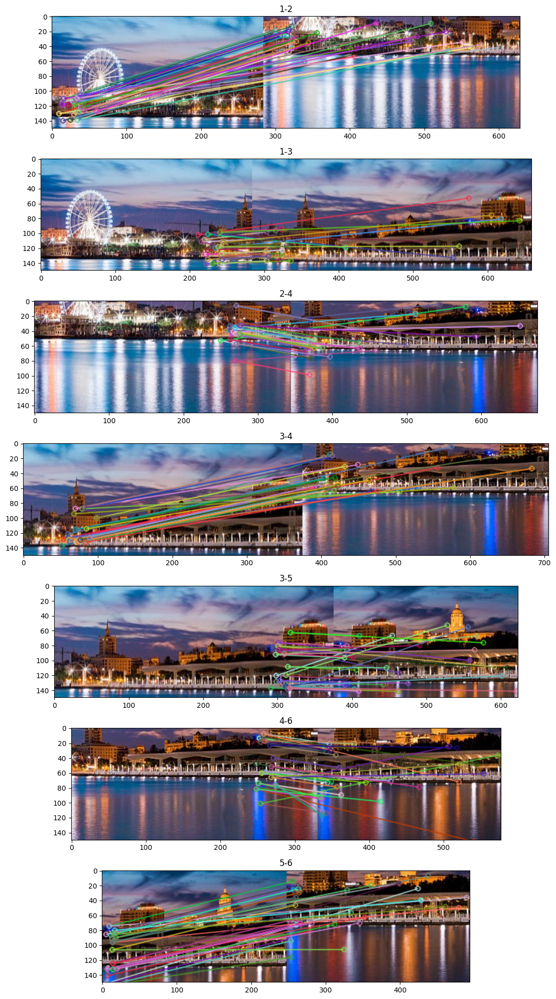

In [ ]:
im_matches1_2 = cv2.drawMatchesKnn(img_rgb1, kp_1, img_rgb2, kp_2, good_match_arr1_2[0:20], None, flags=cv2.DRAW_MATCHES_FLAGS_NOT_DRAW_SINGLE_POINTS)
im_matches1_3 = cv2.drawMatchesKnn(img_rgb1, kp_1, img_rgb3, kp_3, good_match_arr1_3[0:20], None, flags=cv2.DRAW_MATCHES_FLAGS_NOT_DRAW_SINGLE_POINTS)
im_matches2_4 = cv2.drawMatchesKnn(img_rgb2, kp_2, img_rgb4, kp_4, good_match_arr2_4[0:20], None, flags=cv2.DRAW_MATCHES_FLAGS_NOT_DRAW_SINGLE_POINTS)
im_matches3_4 = cv2.drawMatchesKnn(img_rgb3, kp_3, img_rgb4, kp_4, good_match_arr3_4[0:20], None, flags=cv2.DRAW_MATCHES_FLAGS_NOT_DRAW_SINGLE_POINTS)
im_matches3_5 = cv2.drawMatchesKnn(img_rgb3, kp_3, img_rgb5, kp_5, good_match_arr3_5[0:20], None, flags=cv2.DRAW_MATCHES_FLAGS_NOT_DRAW_SINGLE_POINTS)
im_matches4_6 = cv2.drawMatchesKnn(img_rgb4, kp_4, img_rgb6, kp_6, good_match_arr4_6[0:20], None, flags=cv2.DRAW_MATCHES_FLAGS_NOT_DRAW_SINGLE_POINTS)
im_matches5_6 = cv2.drawMatchesKnn(img_rgb5, kp_5, img_rgb6, kp_6, good_match_arr5_6[0:20], None, flags=cv2.DRAW_MATCHES_FLAGS_NOT_DRAW_SINGLE_POINTS)


plt.figure(figsize=(20,20))
plt.subplot(7,1,1),plt.imshow(im_matches1_2), plt.title("1-2")
plt.subplot(7,1,2),plt.imshow(im_matches1_3), plt.title("1-3")
plt.subplot(7,1,3),plt.imshow(im_matches2_4), plt.title("2-4")
plt.subplot(7,1,4),plt.imshow(im_matches3_4), plt.title("3-4")
plt.subplot(7,1,5),plt.imshow(im_matches3_5), plt.title("3-5")
plt.subplot(7,1,6),plt.imshow(im_matches4_6), plt.title("4-6")
plt.subplot(7,1,7),plt.imshow(im_matches5_6), plt.title("5-6")
plt.tight_layout()
plt.show()


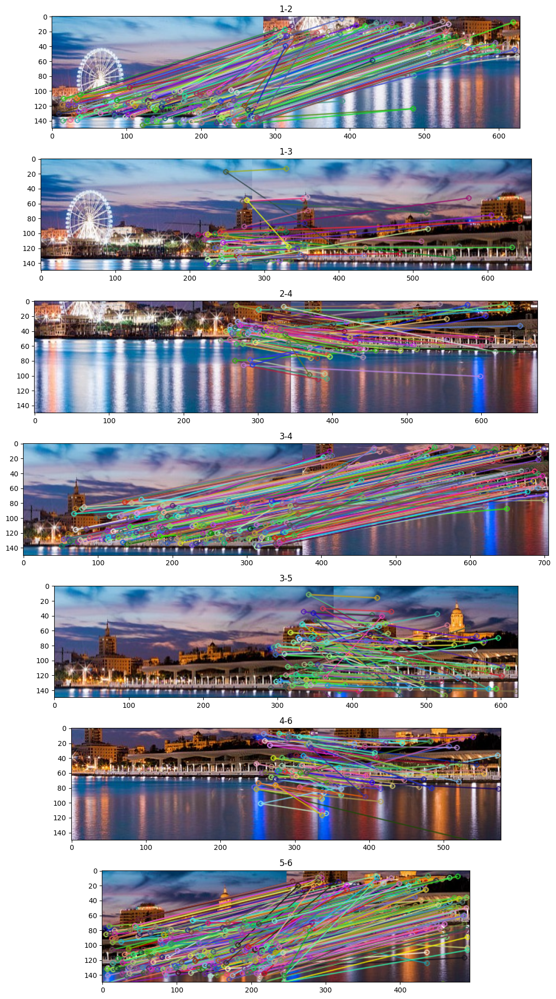

In [ ]:
im_matches1_2 = cv2.drawMatchesKnn(img_rgb1, kp_1, img_rgb2, kp_2, good_match_arr1_2, None, flags=cv2.DRAW_MATCHES_FLAGS_NOT_DRAW_SINGLE_POINTS)
im_matches1_3 = cv2.drawMatchesKnn(img_rgb1, kp_1, img_rgb3, kp_3, good_match_arr1_3, None, flags=cv2.DRAW_MATCHES_FLAGS_NOT_DRAW_SINGLE_POINTS)
im_matches2_4 = cv2.drawMatchesKnn(img_rgb2, kp_2, img_rgb4, kp_4, good_match_arr2_4, None, flags=cv2.DRAW_MATCHES_FLAGS_NOT_DRAW_SINGLE_POINTS)
im_matches3_4 = cv2.drawMatchesKnn(img_rgb3, kp_3, img_rgb4, kp_4, good_match_arr3_4, None, flags=cv2.DRAW_MATCHES_FLAGS_NOT_DRAW_SINGLE_POINTS)
im_matches3_5 = cv2.drawMatchesKnn(img_rgb3, kp_3, img_rgb5, kp_5, good_match_arr3_5, None, flags=cv2.DRAW_MATCHES_FLAGS_NOT_DRAW_SINGLE_POINTS)
im_matches4_6 = cv2.drawMatchesKnn(img_rgb4, kp_4, img_rgb6, kp_6, good_match_arr4_6, None, flags=cv2.DRAW_MATCHES_FLAGS_NOT_DRAW_SINGLE_POINTS)
im_matches5_6 = cv2.drawMatchesKnn(img_rgb5, kp_5, img_rgb6, kp_6, good_match_arr5_6, None, flags=cv2.DRAW_MATCHES_FLAGS_NOT_DRAW_SINGLE_POINTS)


plt.figure(figsize=(20,20))
plt.subplot(7,1,1),plt.imshow(im_matches1_2), plt.title("1-2")
plt.subplot(7,1,2),plt.imshow(im_matches1_3), plt.title("1-3")
plt.subplot(7,1,3),plt.imshow(im_matches2_4), plt.title("2-4")
plt.subplot(7,1,4),plt.imshow(im_matches3_4), plt.title("3-4")
plt.subplot(7,1,5),plt.imshow(im_matches3_5), plt.title("3-5")
plt.subplot(7,1,6),plt.imshow(im_matches4_6), plt.title("4-6")
plt.subplot(7,1,7),plt.imshow(im_matches5_6), plt.title("5-6")
plt.tight_layout()
plt.show()


### Encontrar la matriz de Homografía

In [ ]:
good_kp_1_2 = np.array([kp_1[m.queryIdx].pt for m in good_match_arr1_2[:,0]]).reshape(-1,1,2) #Se queda quieta queryIdx
good_kp_2_1 = np.array([kp_2[m.trainIdx].pt for m in good_match_arr1_2[:,0]]).reshape(-1,1,2) # se mueve trainIdx
H2_1,_ = cv2.findHomography(good_kp_2_1, good_kp_1_2, cv2.RANSAC,5.0)

good_kp_1_3 = np.array([kp_1[m.queryIdx].pt for m in good_match_arr1_3[:,0]]).reshape(-1,1,2) #Se queda quieta queryIdx
good_kp_3_1= np.array([kp_3[m.trainIdx].pt for m in good_match_arr1_3[:,0]]).reshape(-1,1,2) # se mueve trainIdx
H3_1,_ = cv2.findHomography(good_kp_3_1,good_kp_1_3, cv2.RANSAC,5.0)

good_kp_2_4 = np.array([kp_2[m.queryIdx].pt for m in good_match_arr2_4[:,0]]).reshape(-1,1,2) #Se queda quieta queryIdx
good_kp_4_2 = np.array([kp_4[m.trainIdx].pt for m in good_match_arr2_4[:,0]]).reshape(-1,1,2) # se mueve trainIdx
H4_2,_ = cv2.findHomography(good_kp_4_2, good_kp_2_4, cv2.RANSAC,5.0)

good_kp_3_4 = np.array([kp_3[m.queryIdx].pt for m in good_match_arr3_4[:,0]]).reshape(-1,1,2) #Se queda quieta queryIdx
good_kp_4_3 = np.array([kp_4[m.trainIdx].pt for m in good_match_arr3_4[:,0]]).reshape(-1,1,2) # se mueve trainIdx
H4_3,_ = cv2.findHomography(good_kp_4_3,good_kp_3_4 , cv2.RANSAC,5.0)

good_kp_3_5 = np.array([kp_3[m.queryIdx].pt for m in good_match_arr3_5[:,0]]).reshape(-1,1,2) #Se queda quieta queryIdx
good_kp_5_3 = np.array([kp_5[m.trainIdx].pt for m in good_match_arr3_5[:,0]]).reshape(-1,1,2) # se mueve trainIdx
H5_3,_ = cv2.findHomography(good_kp_5_3, good_kp_3_5, cv2.RANSAC,5.0)

good_kp_4_6 = np.array([kp_4[m.queryIdx].pt for m in good_match_arr4_6[:,0]]).reshape(-1,1,2) #Se queda quieta queryIdx
good_kp_6_4 = np.array([kp_6[m.trainIdx].pt for m in good_match_arr4_6[:,0]]).reshape(-1,1,2) # se mueve trainIdx
H6_4,_ = cv2.findHomography(good_kp_6_4, good_kp_4_6, cv2.RANSAC,5.0)

good_kp_5_6 = np.array([kp_5[m.queryIdx].pt for m in good_match_arr5_6[:,0]]).reshape(-1,1,2) #Se queda quieta queryIdx
good_kp_6_5 = np.array([kp_6[m.trainIdx].pt for m in good_match_arr5_6[:,0]]).reshape(-1,1,2) # se mueve trainIdx
H6_5,_ = cv2.findHomography(good_kp_6_5, good_kp_5_6, cv2.RANSAC,5.0)

In [ ]:
ancho1 = img_rgb1.shape[1]
alto1 =  img_rgb1.shape[0] + img_rgb2.shape[0]

In [ ]:
result1 = cv2.warpPerspective(img_rgb2, H2_1, (ancho1,alto1))
result1[:img_rgb1.shape[0],:img_rgb1.shape[1]] = img_rgb1

In [ ]:
result_1 = result1[0:220,:]

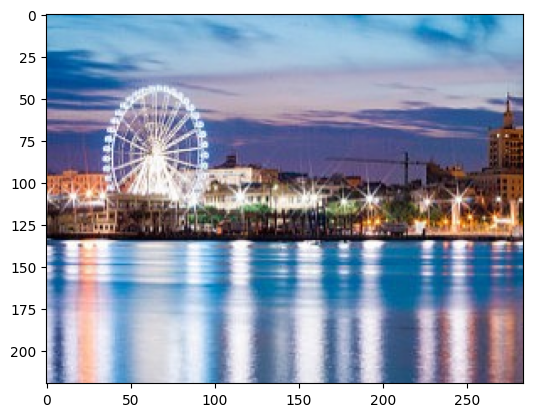

In [ ]:
plt.imshow(result_1)

In [ ]:
result2 = cv2.warpPerspective(img_rgb3,H3_1,(img_rgb1.shape[1]+ img_rgb3.shape[1],result1.shape[0]))
result2[:result1.shape[0],:result1.shape[1]] = result1

In [ ]:
ancho2 = img_rgb3.shape[1] + img_rgb1.shape[1]
alto2 = result1.shape[0]

result2 = cv2.warpPerspective(img_rgb3,H3_1,(img_rgb1.shape[1]+ img_rgb3.shape[1],result1.shape[0]))
result2[:result1.shape[0],:result1.shape[1]] = result1


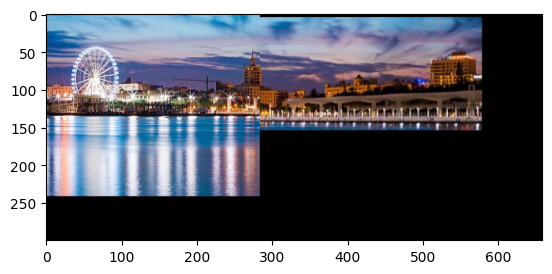

In [ ]:
plt.imshow(result2)

In [ ]:
result_2 = result2[10:220,:550]

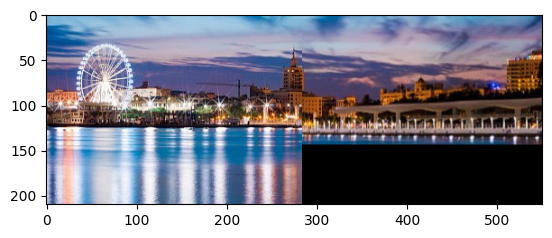

In [ ]:
plt.imshow(result_2)

In [ ]:
H5_1 = np.dot(H3_1,H5_3)
result3 = cv2.warpPerspective(img_rgb5,H5_1,(img_rgb5.shape[1]+ result_2.shape[1],result_2.shape[0]))

In [ ]:
result3[:result_2.shape[0],:result_2.shape[1]] = result_2

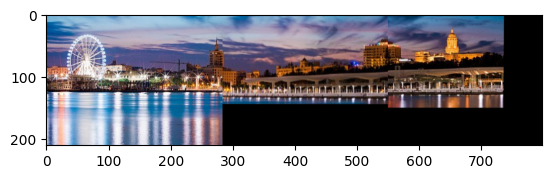

In [ ]:
plt.imshow(result3)

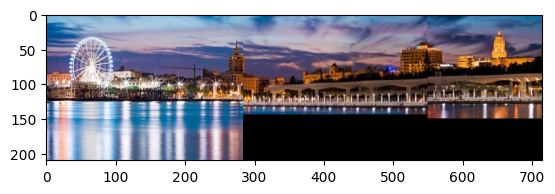

In [ ]:
result_3 = result3[:, :715]
# result_3 = result3[150:200,280:715]
plt.imshow(result_3)

In [ ]:
H4_1 = np.dot(H2_1, H4_2)
result4 = cv2.warpPerspective(img_rgb4, H4_1, (img_rgb6.shape[1] + result_3.shape[1], result_3.shape[0]))

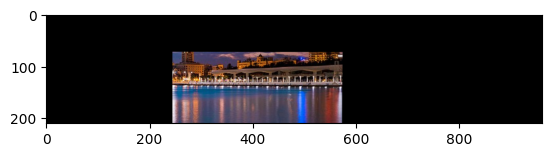

In [ ]:
plt.imshow(result4)

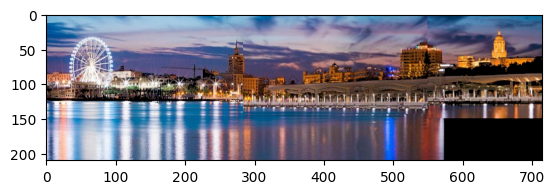

In [ ]:
# Obtener las dimensiones de las imágenes
height_original, width_original, _ = result_3.shape

# Definir el umbral para considerar un píxel como negro
umbral = 50

# Recorrer cada píxel de la imagen original
for y in range(height_original):
    for x in range(width_original):
        # Obtener los valores RGB del píxel de la imagen original
        b, g, r = result_3[y, x]

        # Verificar si el píxel es negro
        if b < umbral and g < umbral and r < umbral:
            # Reemplazar el píxel negro con el correspondiente de result4
            result_3[y, x] = result4[y, x]

# Mostrar la imagen modificada
plt.imshow(result_3)
plt.show()


In [ ]:
H63_1 = np.dot(H4_1,H6_4)
result7 = cv2.warpPerspective(img_rgb6, H63_1, (img_rgb6.shape[1] + result_3.shape[1], result_3.shape[0]))

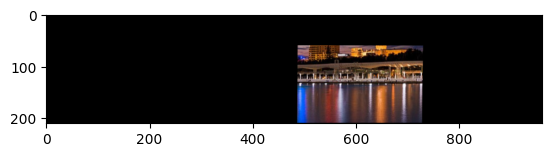

In [ ]:
plt.imshow(result7)

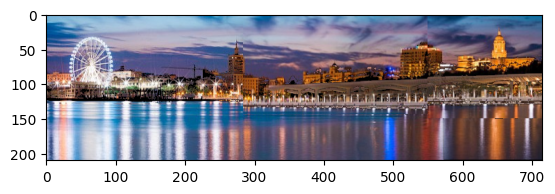

In [ ]:
# Obtener las dimensiones de las imágenes
height_original, width_original, _ = result_3.shape

# Definir el umbral para considerar un píxel como negro
umbral = 50

# Recorrer cada píxel de la imagen original
for y in range(height_original):
    for x in range(width_original):
        # Obtener los valores RGB del píxel de la imagen original
        b, g, r = result_3[y, x]

        # Verificar si el píxel es negro
        if b < umbral and g < umbral and r < umbral:
            # Reemplazar el píxel negro con el correspondiente de result4
            result_3[y, x] = result7[y, x]

# Mostrar la imagen modificada
plt.imshow(result_3)
plt.show()

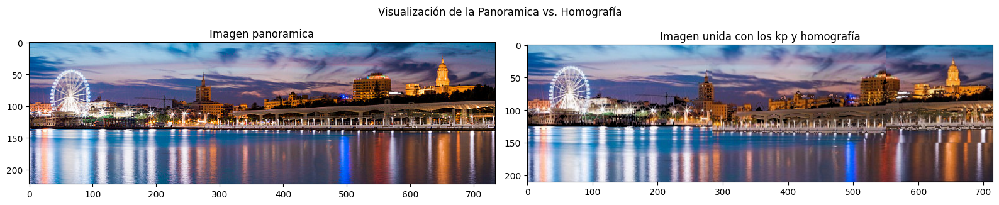

In [ ]:
img_panoramica = cv2.imread("/content/STITCH/panoramica.jpg",0)
img_rgbpan = cv2.cvtColor(cv2.imread("/content/STITCH/panoramica.jpg"), cv2.COLOR_BGR2RGB)

plt.figure(figsize=(16,14))
plt.suptitle("Visualización de la Panoramica vs. Homografía", y=0.61)
plt.subplot(1,2,1), plt.imshow(img_rgbpan)
plt.title("Imagen panoramica")
plt.subplot(1,2,2), plt.imshow(result_3)
plt.title("Imagen unida con los kp y homografía")


plt.tight_layout()
plt.show()

# **Orb**

 Sus siglas significan Oriented Fast y Rotativo Brief el cual combina de dos algoritmos para extracción de caracteristicas los cuales son FAST (Features from Accelerated Segment Test) y con la construcción de descriptores usando BRIEF (Binary Robust Independent Elementary Feature)

 ORB combina la detección de puntos clave mediante FAST con la creación de descriptores mediante BRIEF, lo que lo hace eficaz para el emparejamiento de imágenes y el reconocimiento de objetos.


In [ ]:
feature_extractor = cv2.ORB_create()
kporb_1,desorb_1 = feature_extractor.detectAndCompute(img_gris1,None)
kporb_2,desorb_2 = feature_extractor.detectAndCompute(img_gris2,None)
kporb_3,desorb_3 = feature_extractor.detectAndCompute(img_gris3,None)
kporb_4,desorb_4 = feature_extractor.detectAndCompute(img_gris4,None)
kporb_5,desorb_5 = feature_extractor.detectAndCompute(img_gris5,None)
kporb_6,desorb_6 = feature_extractor.detectAndCompute(img_gris6,None)

In [ ]:
print("Keypoints imagen 1: ",np.array(kporb_1).shape,np.array(desorb_1).shape )
print("Keypoints imagen 2: ",np.array(kporb_2).shape, np.array(desorb_2).shape)
print("Keypoints imagen 3: ",np.array(kporb_3).shape, np.array(desorb_3).shape)
print("Keypoints imagen 4: ",np.array(kporb_4).shape, np.array(desorb_4).shape)
print("Keypoints imagen 5: ",np.array(kporb_5).shape, np.array(desorb_5).shape)
print("Keypoints imagen 6: ",np.array(kporb_6).shape, np.array(desorb_6).shape)

Keypoints imagen 1:  (330,) (330, 32)
Keypoints imagen 2:  (316,) (316, 32)
Keypoints imagen 3:  (349,) (349, 32)
Keypoints imagen 4:  (368,) (368, 32)
Keypoints imagen 5:  (379,) (379, 32)
Keypoints imagen 6:  (375,) (375, 32)


In [ ]:
im_kporb_1 = cv2.drawKeypoints(img_rgb1, kporb_1, None, flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
im_kporb_2 = cv2.drawKeypoints(img_rgb2, kporb_2, None, flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
im_kporb_3 = cv2.drawKeypoints(img_rgb3, kporb_3, None, flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
im_kporb_4 = cv2.drawKeypoints(img_rgb4, kporb_4, None, flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
im_kporb_5 = cv2.drawKeypoints(img_rgb5, kporb_5, None, flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
im_kporb_6 = cv2.drawKeypoints(img_rgb6, kporb_6, None, flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)

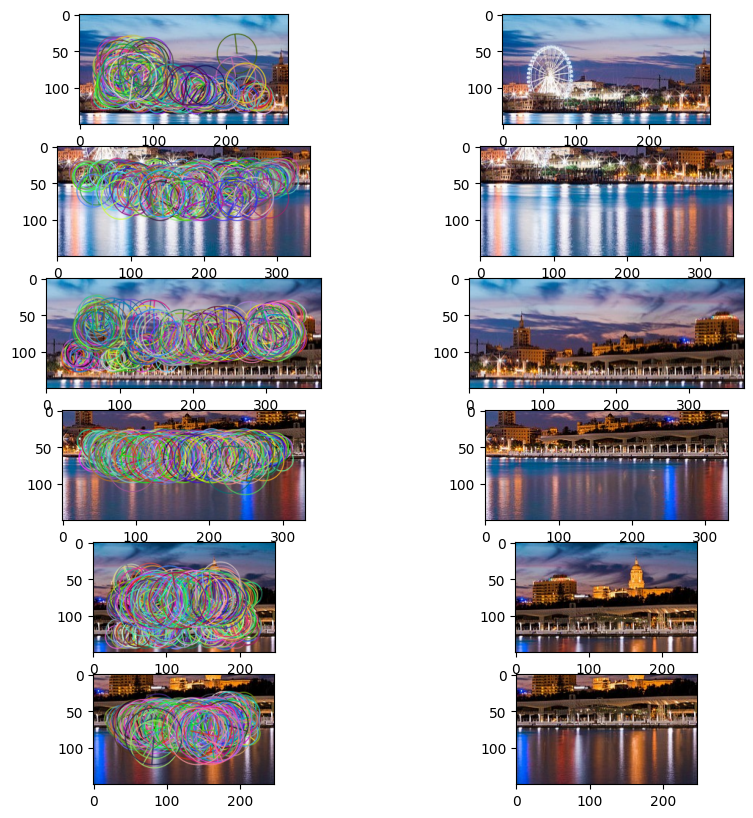

In [ ]:
plt.figure(figsize=(10,10))
plt.subplot(6,2,1),plt.imshow(im_kporb_1, cmap="gray")
plt.subplot(6,2,2),plt.imshow(img_rgb1, cmap="gray")
plt.subplot(6,2,3),plt.imshow(im_kporb_2, cmap="gray")
plt.subplot(6,2,4),plt.imshow(img_rgb2, cmap="gray")
plt.subplot(6,2,5),plt.imshow(im_kporb_3, cmap="gray")
plt.subplot(6,2,6),plt.imshow(img_rgb3, cmap="gray")
plt.subplot(6,2,7),plt.imshow(im_kporb_4, cmap="gray")
plt.subplot(6,2,8),plt.imshow(img_rgb4, cmap="gray")
plt.subplot(6,2,9),plt.imshow(im_kporb_5, cmap="gray")
plt.subplot(6,2,10),plt.imshow(img_rgb5, cmap="gray")
plt.subplot(6,2,11),plt.imshow(im_kporb_6, cmap="gray")
plt.subplot(6,2,12),plt.imshow(img_rgb6, cmap="gray")
plt.show()

In [ ]:
bf = cv2.BFMatcher()
matches1to2 = bf.knnMatch(desorb_1, desorb_2, k=2)
matches1to3 = bf.knnMatch(desorb_1, desorb_3, k=2)
matches2to4 = bf.knnMatch(desorb_2,desorb_4, k=2)
matches3to4 = bf.knnMatch(desorb_3, desorb_4, k=2)
matches3to5 = bf.knnMatch(desorb_3, desorb_5, k=2)
matches4to6 = bf.knnMatch(desorb_4,desorb_6,  k=2)
matches5to6 = bf.knnMatch(desorb_5, desorb_6, k=2)

In [ ]:
good_matches_1_2 = []
good_matches_1_3 = []
good_matches_2_4 = []
good_matches_3_4 = []
good_matches_3_5 = []
good_matches_4_6 = []
good_matches_5_6 = []

for m in matches1to2:
  if m[0].distance / m[1].distance < 40:
    good_matches_1_2.append(m)
good_match_arr1_2 = np.array(good_matches_1_2)

for m in matches1to3:
  if m[0].distance / m[1].distance < 40:
    good_matches_1_3.append(m)
good_match_arr1_3 = np.array(good_matches_1_3)

for m in matches2to4:
  if m[0].distance / m[1].distance < 40:
    good_matches_2_4.append(m)
good_match_arr2_4 = np.array(good_matches_2_4)

for m in matches3to4:
  if m[0].distance / m[1].distance < 40:
    good_matches_3_4.append(m)
good_match_arr3_4 = np.array(good_matches_3_4)

for m in matches3to5:
  if m[0].distance / m[1].distance < 40:
    good_matches_3_5.append(m)
good_match_arr3_5 = np.array(good_matches_3_5)

for m in matches4to6:
  if m[0].distance / m[1].distance < 40:
    good_matches_4_6.append(m)
good_match_arr4_6 = np.array(good_matches_4_6)

for m in matches5to6:
  if m[0].distance / m[1].distance < 40:
    good_matches_5_6.append(m)
good_match_arr5_6 = np.array(good_matches_5_6)


print(good_match_arr1_2.shape)
print(good_match_arr1_3.shape)
print(good_match_arr2_4.shape)
print(good_match_arr3_4.shape)
print(good_match_arr3_5.shape)
print(good_match_arr4_6.shape)
print(good_match_arr5_6.shape)

(330, 2)
(330, 2)
(316, 2)
(349, 2)
(349, 2)
(368, 2)
(379, 2)


In [ ]:
good_matches_1_2 = []
good_matches_1_3 = []
good_matches_2_4 = []
good_matches_3_4 = []
good_matches_3_5 = []
good_matches_4_6 = []
good_matches_5_6 = []

for m in matches1to2:
  if m[0].distance / m[1].distance < 0.8:
    good_matches_1_2.append(m)
good_match_arr1_2 = np.array(good_matches_1_2)

for m in matches1to3:
  if m[0].distance / m[1].distance < 0.8:
    good_matches_1_3.append(m)
good_match_arr1_3 = np.array(good_matches_1_3)

for m in matches2to4:
  if m[0].distance / m[1].distance < 0.8:
    good_matches_2_4.append(m)
good_match_arr2_4 = np.array(good_matches_2_4)

for m in matches3to4:
  if m[0].distance / m[1].distance < 0.8:
    good_matches_3_4.append(m)
good_match_arr3_4 = np.array(good_matches_3_4)

for m in matches3to5:
  if m[0].distance / m[1].distance < 0.8:
    good_matches_3_5.append(m)
good_match_arr3_5 = np.array(good_matches_3_5)

for m in matches4to6:
  if m[0].distance / m[1].distance < 0.8:
    good_matches_4_6.append(m)
good_match_arr4_6 = np.array(good_matches_4_6)

for m in matches5to6:
  if m[0].distance / m[1].distance < 0.8:
    good_matches_5_6.append(m)
good_match_arr5_6 = np.array(good_matches_5_6)


print(good_match_arr1_2.shape)
print(good_match_arr1_3.shape)
print(good_match_arr2_4.shape)
print(good_match_arr3_4.shape)
print(good_match_arr3_5.shape)
print(good_match_arr4_6.shape)
print(good_match_arr5_6.shape)

(9, 2)
(10, 2)
(14, 2)
(6, 2)
(16, 2)
(25, 2)
(93, 2)


### En el caso del ORB, se denota que a menor es esa distancia entre keypoints existen pocos valores del good match para las imágenes, por lo que al realizar la homografía podrá presentar incongruencias por las bajas similitudes en cada punto del arreglo. Se usaron los dos ejemplos viendo una distancia menor de 40 y una distancia menor a 0.8

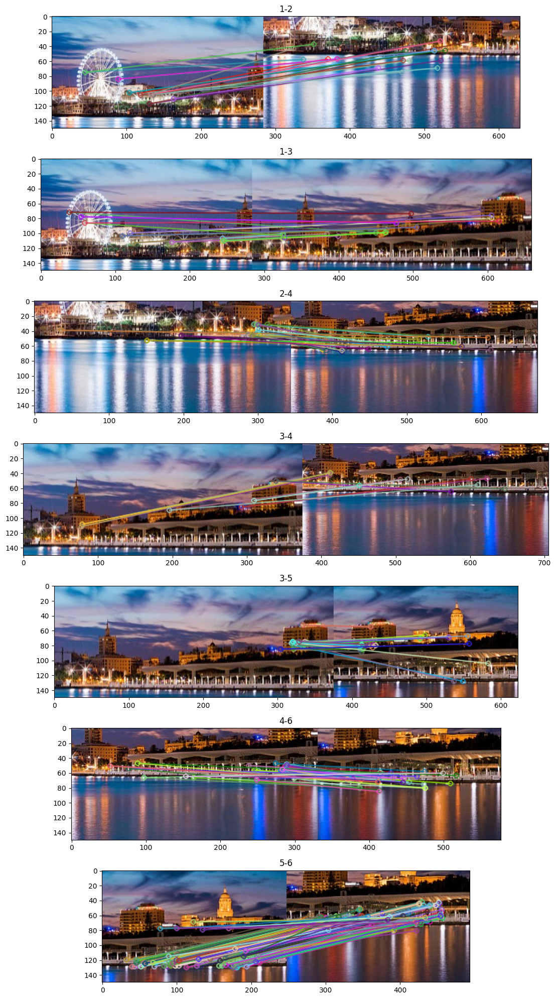

In [ ]:
im_matches1_2 = cv2.drawMatchesKnn(img_rgb1, kporb_1, img_rgb2, kporb_2, good_match_arr1_2, None, flags=cv2.DRAW_MATCHES_FLAGS_NOT_DRAW_SINGLE_POINTS)
im_matches1_3 = cv2.drawMatchesKnn(img_rgb1, kporb_1, img_rgb3, kporb_3, good_match_arr1_3, None, flags=cv2.DRAW_MATCHES_FLAGS_NOT_DRAW_SINGLE_POINTS)
im_matches2_4 = cv2.drawMatchesKnn(img_rgb2, kporb_2, img_rgb4, kporb_4, good_match_arr2_4, None, flags=cv2.DRAW_MATCHES_FLAGS_NOT_DRAW_SINGLE_POINTS)
im_matches3_4 = cv2.drawMatchesKnn(img_rgb3, kporb_3, img_rgb4, kporb_4, good_match_arr3_4, None, flags=cv2.DRAW_MATCHES_FLAGS_NOT_DRAW_SINGLE_POINTS)
im_matches3_5 = cv2.drawMatchesKnn(img_rgb3, kporb_3, img_rgb5, kporb_5, good_match_arr3_5, None, flags=cv2.DRAW_MATCHES_FLAGS_NOT_DRAW_SINGLE_POINTS)
im_matches4_6 = cv2.drawMatchesKnn(img_rgb4, kporb_4, img_rgb6, kporb_6, good_match_arr4_6, None, flags=cv2.DRAW_MATCHES_FLAGS_NOT_DRAW_SINGLE_POINTS)
im_matches5_6 = cv2.drawMatchesKnn(img_rgb5, kporb_5, img_rgb6, kporb_6, good_match_arr5_6, None, flags=cv2.DRAW_MATCHES_FLAGS_NOT_DRAW_SINGLE_POINTS)


plt.figure(figsize=(20,20))
plt.subplot(7,1,1),plt.imshow(im_matches1_2), plt.title("1-2")
plt.subplot(7,1,2),plt.imshow(im_matches1_3), plt.title("1-3")
plt.subplot(7,1,3),plt.imshow(im_matches2_4), plt.title("2-4")
plt.subplot(7,1,4),plt.imshow(im_matches3_4), plt.title("3-4")
plt.subplot(7,1,5),plt.imshow(im_matches3_5), plt.title("3-5")
plt.subplot(7,1,6),plt.imshow(im_matches4_6), plt.title("4-6")
plt.subplot(7,1,7),plt.imshow(im_matches5_6), plt.title("5-6")
plt.tight_layout()
plt.show()

In [ ]:
good_kp_1_2 = np.array([kporb_1[m.queryIdx].pt for m in good_match_arr1_2[:,0]]).reshape(-1,1,2) #Se queda quieta queryIdx
good_kp_2_1 = np.array([kporb_2[m.trainIdx].pt for m in good_match_arr1_2[:,0]]).reshape(-1,1,2) # se mueve trainIdx
H2_1,_ = cv2.findHomography(good_kp_2_1, good_kp_1_2, cv2.RANSAC,5.0)

good_kp_1_3 = np.array([kporb_1[m.queryIdx].pt for m in good_match_arr1_3[:,0]]).reshape(-1,1,2) #Se queda quieta queryIdx
good_kp_3_1= np.array([kporb_3[m.trainIdx].pt for m in good_match_arr1_3[:,0]]).reshape(-1,1,2) # se mueve trainIdx
H3_1,_ = cv2.findHomography(good_kp_3_1,good_kp_1_3, cv2.RANSAC,5.0)

good_kp_2_4 = np.array([kporb_2[m.queryIdx].pt for m in good_match_arr2_4[:,0]]).reshape(-1,1,2) #Se queda quieta queryIdx
good_kp_4_2 = np.array([kporb_4[m.trainIdx].pt for m in good_match_arr2_4[:,0]]).reshape(-1,1,2) # se mueve trainIdx
H4_2,_ = cv2.findHomography(good_kp_4_2, good_kp_2_4, cv2.RANSAC,5.0)

good_kp_3_4 = np.array([kporb_3[m.queryIdx].pt for m in good_match_arr3_4[:,0]]).reshape(-1,1,2) #Se queda quieta queryIdx
good_kp_4_3 = np.array([kporb_4[m.trainIdx].pt for m in good_match_arr3_4[:,0]]).reshape(-1,1,2) # se mueve trainIdx
H4_3,_ = cv2.findHomography(good_kp_4_3,good_kp_3_4 , cv2.RANSAC,5.0)

good_kp_3_5 = np.array([kporb_3[m.queryIdx].pt for m in good_match_arr3_5[:,0]]).reshape(-1,1,2) #Se queda quieta queryIdx
good_kp_5_3 = np.array([kporb_5[m.trainIdx].pt for m in good_match_arr3_5[:,0]]).reshape(-1,1,2) # se mueve trainIdx
H5_3,_ = cv2.findHomography(good_kp_5_3, good_kp_3_5, cv2.RANSAC,5.0)

good_kp_4_6 = np.array([kporb_4[m.queryIdx].pt for m in good_match_arr4_6[:,0]]).reshape(-1,1,2) #Se queda quieta queryIdx
good_kp_6_4 = np.array([kporb_6[m.trainIdx].pt for m in good_match_arr4_6[:,0]]).reshape(-1,1,2) # se mueve trainIdx
H6_4,_ = cv2.findHomography(good_kp_6_4, good_kp_4_6, cv2.RANSAC,5.0)

good_kp_5_6 = np.array([kporb_5[m.queryIdx].pt for m in good_match_arr5_6[:,0]]).reshape(-1,1,2) #Se queda quieta queryIdx
good_kp_6_5 = np.array([kporb_6[m.trainIdx].pt for m in good_match_arr5_6[:,0]]).reshape(-1,1,2) # se mueve trainIdx
H6_5,_ = cv2.findHomography(good_kp_6_5, good_kp_5_6, cv2.RANSAC,5.0)

In [ ]:
ancho = img_rgb1.shape[1] + img_rgb2.shape[1] + img_rgb3.shape[1] + img_rgb4.shape[1] + img_rgb5.shape[1] + img_rgb6.shape[1] + img_rgb1.shape[1]
alto = img_rgb1.shape[0] + img_rgb2.shape[0]
print(ancho, alto)
ancho1 = img_rgb1.shape[1]
alto1 =  img_rgb1.shape[0] + img_rgb2.shape[0]

2113 300


In [ ]:
result1 = cv2.warpPerspective(img_rgb2, H2_1, (ancho1,alto1))
result1[:img_rgb1.shape[0],:img_rgb1.shape[1]] = img_rgb1

result2 = cv2.warpPerspective(img_rgb3,H3_1,(img_rgb1.shape[1]+ img_rgb3.shape[1],result1.shape[0]))
result2[:result1.shape[0],:result1.shape[1]] = result1

result3 = cv2.warpPerspective(img_rgb4, H4_3,(img_rgb4.shape[1]+ img_rgb3.shape[1],result1.shape[0]))
result3[:result2.shape[0],:result2.shape[1]] = result2

result4 = cv2.warpPerspective(img_rgb4, H4_2,(result2.shape[1]+ img_rgb5.shape[1],result1.shape[0]))
result4[:result2.shape[0],:result2.shape[1]] = result2

result5 = cv2.warpPerspective(img_rgb5,H5_3, (result2.shape[1]+ img_rgb5.shape[1],result1.shape[0]))
result5[:result3.shape[0],:result3.shape[1]] = result3

aligned_img_6_4 =cv2.warpPerspective(img_rgb6, H6_4, (ancho,alto))
aligned_img_6_5 =cv2.warpPerspective(img_rgb6, H6_5, (ancho,alto))

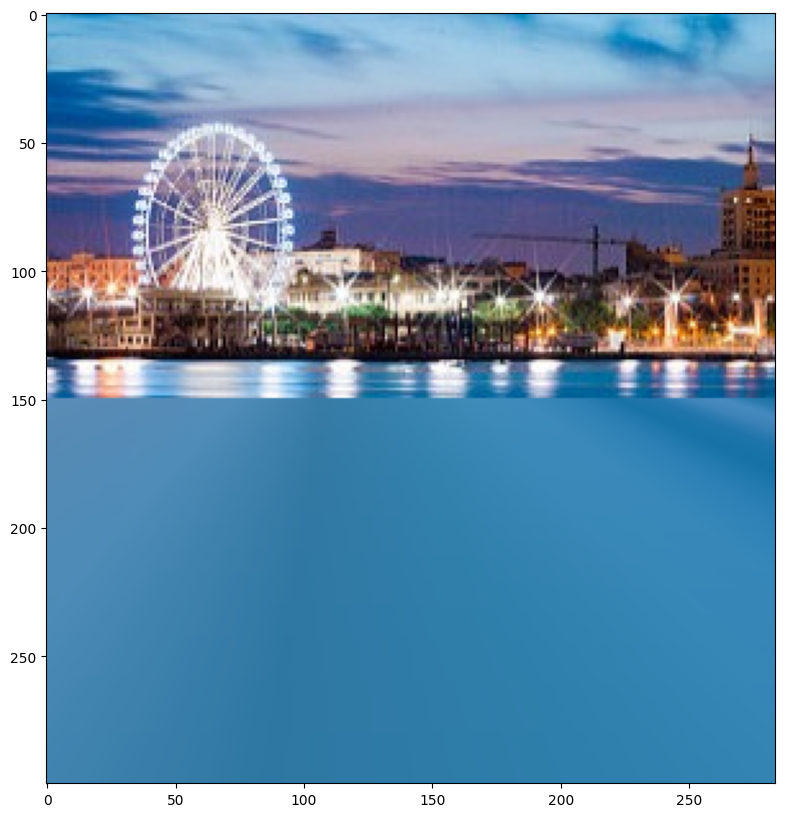

In [ ]:
plt.figure(figsize=(10,10))
plt.imshow(result1)

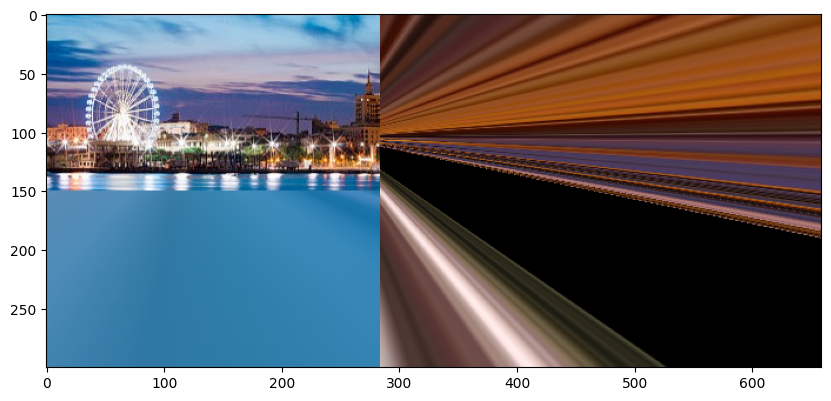

In [ ]:
plt.figure(figsize=(10,10))
plt.imshow(result2)

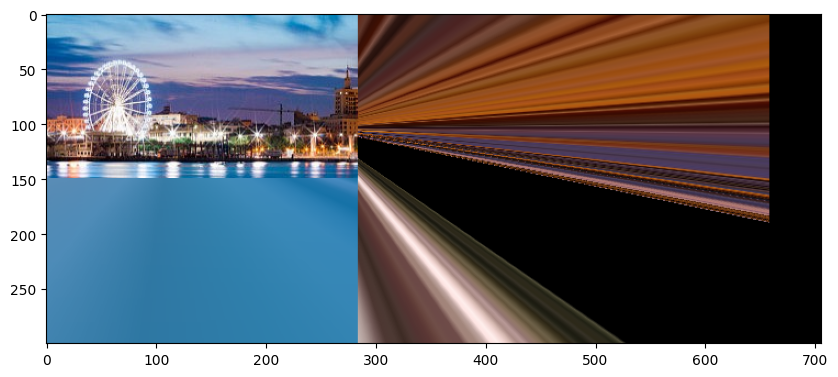

In [ ]:
plt.figure(figsize=(10,10))
plt.imshow(result3)

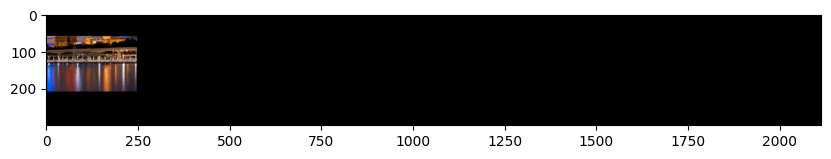

In [ ]:
plt.figure(figsize=(10,10))
plt.imshow(aligned_img_6_5)

TypeError: imshow() missing 1 required positional argument: 'X'

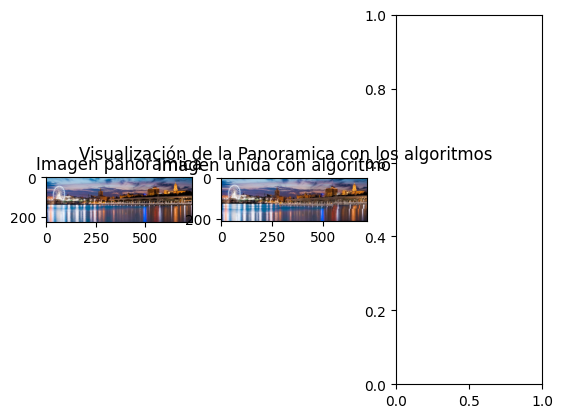

In [ ]:
plt.figure(figsize=(12,10))
plt.suptitle("Visualización de la Panoramica con los algoritmos", y=0.61)
plt.subplot(1,3,1), plt.imshow(img_rgbpan)
plt.title("Imagen panoramica")
plt.subplot(1,3,2), plt.imshow(result_3)
plt.title("Imagen unida con algoritmo SIFT")
plt.subplot(1,3,3), plt.imshow(result3)
plt.title("Imagen unida con algoritmo ORB")

plt.tight_layout()
plt.show()

### Como bien se mencionó anteriormente, y después de haber hecho la visualización de matches, la homografía y unión de imágenes, se vuelve a denotar que por el poco buenos matches con su distancia corta, el algoritmo no logra hacer adecuadamente la unión de imágenes.